# Importing Libraries

In [11]:
import os
import cv2
import numpy as np
import pandas as pd
from skimage.feature import greycomatrix, greycoprops
from matplotlib import pyplot as plt
%matplotlib inline
from os import listdir
from os.path import isfile, join

# Function to Create a new dataframe

In [12]:
def create_empty_df():
    df = pd.DataFrame()
    df['area'] = None
    df['perimeter'] = None
    df['red_mean'] = None
    df['green_mean'] = None
    df['blue_mean'] = None
    df['f1'] = None
    df['f2'] = None
    df['red_std'] = None
    df['green_std'] = None
    df['blue_std'] = None
    df['f4'] = None
    df['f5'] = None
    df['f6'] = None
    df['f7'] = None
    df['f8'] = None
    df['label'] = None
    return df

# Function to extract the features

In [13]:
filename='/Users/dan/Desktop/p2/image lis/1.jpeg'
def feature_extractor(filename):
    '''
    input params: 
    filename : path of the file that we want to process

    Output params:
    l : Feature vector
    '''

    try:
        main_img = cv2.imread(filename)
        img = cv2.cvtColor(main_img, cv2.COLOR_BGR2RGB)
    except:
        return "Invalid"

    #Preprocessing
    

    gs = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    blur = cv2.GaussianBlur(gs, (25,25),0)
    ret_otsu,im_bw_otsu = cv2.threshold(blur,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)
    kernel = np.ones((25,25),np.uint8)
    closing = cv2.morphologyEx(im_bw_otsu, cv2.MORPH_CLOSE, kernel)

    #Shape features
    contours, _ = cv2.findContours(closing,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
    cnt = contours[0]
    M = cv2.moments(cnt)
    area = cv2.contourArea(cnt)
    if area==0:
        return "Invalid"
    perimeter = cv2.arcLength(cnt,True)

    current_frame = main_img
    filtered_image = closing/255

    #Elementwise Multiplication of range bounded filtered_image with current_frame
    current_frame[0:current_frame.shape[0], 0:current_frame.shape[1], 0] = np.multiply(current_frame[0:current_frame.shape[0], 0:current_frame.shape[1], 0], filtered_image) #B channel
    current_frame[0:current_frame.shape[0], 0:current_frame.shape[1], 1] = np.multiply(current_frame[0:current_frame.shape[0], 0:current_frame.shape[1], 1], filtered_image) #G channel
    current_frame[0:current_frame.shape[0], 0:current_frame.shape[1], 2] = np.multiply(current_frame[0:current_frame.shape[0], 0:current_frame.shape[1], 2], filtered_image) #R channel

    img = current_frame


    #Color features
    red_channel = img[:,:,0]
    green_channel = img[:,:,1] #show the intensities of green channe
    blue_channel = img[:,:,2]

    red_mean = np.mean(red_channel)
    green_mean = np.mean(green_channel)
    blue_mean = np.mean(blue_channel)
    #standard deviation for colour feature from the image.    
    red_std = np.std(red_channel)
    green_std = np.std(green_channel)
    blue_std = np.std(blue_channel)
    
    #amt.of green color in the image
    gr = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    boundaries = [([30,0,0],[70,255,255])]
    for (lower, upper) in boundaries:
        mask = cv2.inRange(gr, (36, 0, 0), (70, 255,255))
        ratio_green = cv2.countNonZero(mask)/(img.size/3)
        f1=np.round(ratio_green, 2)
    #amt. of non green part of the image   
    f2=1-f1

    #Texture features using grey level cooccurance matrix
    img=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    g=greycomatrix(img, [1], [0, np.pi/4, np.pi/2, 3*np.pi/4])

    #with the help of glcm find the contrast
    contrast = greycoprops(g, 'contrast')
    f4=contrast[0][0]+contrast[0][1]+contrast[0][2]+contrast[0][3]
    #[0][3] represent no. of times grey level 3 appears at the right of 0


    #with the help of glcm find the dissimilarity 
    dissimilarity = greycoprops(g, prop='dissimilarity')
    f5=dissimilarity[0][0]+dissimilarity[0][1]+dissimilarity[0][2]+dissimilarity[0][3]

    #with the help of glcm find the homogeneity
    homogeneity = greycoprops(g, prop='homogeneity')
    f6=homogeneity[0][0]+homogeneity[0][1]+homogeneity[0][2]+homogeneity[0][3]

    energy = greycoprops(g, prop='energy')
    f7=energy[0][0]+energy[0][1]+energy[0][2]+energy[0][3]


    correlation = greycoprops(g,prop= 'correlation')
    f8=correlation[0][0]+correlation[0][1]+correlation[0][2]+correlation[0][3]



    l = [area, perimeter, red_mean, green_mean, blue_mean,
         f1, f2, red_std, green_std, blue_std,
        f4,f5,f6,f7,f8]
    return l


# Function to process one folder

In [14]:
folderpath='/Users/dan/Desktop/p2/folderpaths/'
def process_folder(folderpath,df_f,label_f):
    '''
    input params:
    folderpath : Path of the folder that we want to process
    df_f = dataframe for specific disease
    label_f : label corresponding to the specific disease

    Output params:
    df_f = Dataframe consisting processed vectors
    '''
    imagelist = os.listdir(folderpath)  # stores all the imagepaths in the python list
    for image in imagelist:
        imagepath = os.path.join(folderpath, image)
        im_feature = feature_extractor(imagepath) 
        if im_feature == "Invalid":
            continue
        im_feature.append(label_f)  # appending label to feature vector
        df_f.loc[len(df_f)] = im_feature 
        if len(df_f)%500 ==0:
            print(len(df_f))

    return df_f


In [15]:

def process_plant(folderpaths, labels, savepath):
    '''
    input params:
    folderpaths : List of the folderpaths for specific Plant
    labels : List of labels 
    savepath : Path to export datasheet

    Output params:
    None
    '''
    datasheet = create_empty_df()
    for i in range(len(folderpaths)):
        datasheet = process_folder(folderpaths[i],datasheet,labels[i])

    datasheet.to_excel(savepath)

    return None


# Data Preprocessing

**Tomato**

In [16]:
pip install openpyxl


Note: you may need to restart the kernel to use updated packages.


In [17]:
global_folder = '/Users/dan/Desktop/p2/folderpaths/'

folderpaths = [global_folder+ 'Tomato_healthy',
              global_folder+ 'Tomato_Bacterial_spot',
              global_folder+ 'Tomato_Early_blight',
              global_folder+ 'Tomato_Late_blight',
              global_folder+ 'Tomato_Leaf_Mold',
              global_folder+ 'Tomato_Septoria_leaf_spot',
              global_folder+'Tomato_Spider_mites_Two_spotted_spider_mite',
              global_folder+ 'Tomato__Target_Spot',
              global_folder+'Tomato__Tomato_YellowLeaf__Curl_Virus',
              global_folder+ 'Tomato__Tomato_mosaic_virus'
              ]

labels = [0,1,2,3,4,5,6,7,8,9,10]
savepath = '/Users/dan/Desktop/p2/dataset_tomato.xlsx'
process_plant(folderpaths, labels, savepath)

/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

1000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

1500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/U

2000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

2500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

3000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

3500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

4000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

4500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

5000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

5500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

6000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

6500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Use

7000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

7500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

8000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

8500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

9000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

9500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

10000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

10500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

11000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

11500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Use

12000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

12500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

13000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

13500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/U

14000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

14500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

15000


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/U

15500


/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/Users/dan/miniconda3/lib/python3.10/site-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/U

5.2. Data Cleaning and Machine Learning Model training and testing

In [18]:

# EDA MOdule importing
import shutil
shutil.copy('/Users/dan/Desktop/p2/process_image.py','EDA.py')
#import pandas as pd
#import matplotlib.pyplot as plt
#import numpy as np
import seaborn as sns
import EDA as eda
#raw_data = ('/Users/dan/Desktop/p2/dataset_tomato.xlsx')
raw_data = pd.read_excel('/Users/dan/Desktop/p2/dataset_tomato.xlsx')
raw_data.drop(['Unnamed: 0'],axis = 1, inplace=True)
#eda.correlation(raw_data)
#eda.correlationlist(raw_data)
cleaned_data = raw_data.drop(['green_mean', 'red_std', 'blue_std', 'f5', 'f8','f1'],axis = 1, inplace=False)
#cleaned_data = eda.removenullrows(cleaned_data)
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.svm import SVC
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import KFold 


In [19]:
df = cleaned_data.reset_index()
X = df.drop(['index','label'],axis = 1, inplace=False)
y = df['label']
print(X.shape)
print(y.shape)


(15912, 9)
(15912,)


In [20]:
k = 5
kf = KFold(n_splits=k, random_state=9, shuffle = True)
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier(random_state = 50,n_estimators = 50,max_samples = 0.7)
 
acc_score = []
for train_index , test_index in kf.split(X):
    X_train , X_test = X.iloc[train_index,:],X.iloc[test_index,:]
    y_train , y_test = y[train_index] , y[test_index]
    model = RandomForestClassifier(random_state = 50,n_estimators = 50,max_samples = 0.7)
    model.fit(X_train,y_train)
    pred_values = model.predict(X_test)            # classification
    acc = accuracy_score(pred_values , y_test)     # Classification

    #acc = model.score(X_test,y_test)                # Regression
    
    acc_score.append(acc)
     
avg_acc_score = sum(acc_score)/k
 
print('Score of each fold - {}'.format(acc_score))
print('Avg Score : {}'.format(avg_acc_score))




Score of each fold - [0.6754633993088281, 0.651272384542884, 0.6624764299182904, 0.6734758013827781, 0.6587052168447517]
Avg Score : 0.6642786463995065


5.3. Evaluation

/Users/dan/miniconda3/lib/python3.10/site-packages/sklearn/utils/deprecation.py:86: FutureWarning: Function plot_roc_curve is deprecated; This will be removed in v0.5.0. Please use scikitplot.metrics.plot_roc instead.
  warnings.warn(msg, category=FutureWarning)


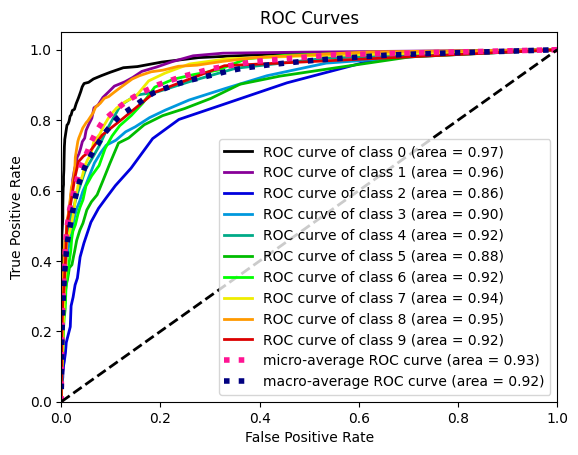

ImportError: cannot import name 'plot_confusion_matrix' from 'sklearn.metrics' (/Users/dan/miniconda3/lib/python3.10/site-packages/sklearn/metrics/__init__.py)

In [21]:

!pip install scikit-plot
import scikitplot as skplt
import matplotlib.pyplot as plt

y_true = y_test
y_probas = model.predict_proba(X_test)
skplt.metrics.plot_roc_curve(y_true, y_probas)
plt.show()
from sklearn.metrics import plot_confusion_matrix
y_pred = model.predict(X_test)
plot_confusion_matrix(model, X_test, y_test, values_format = 'd',cmap = 'Blues',display_labels = ['0','1','2','3'])
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred, [0,1,2,3]))
from sklearn.ensemble import RandomForestClassifier
lm = RandomForestClassifier(random_state = 50,n_estimators = 50,max_samples = 0.7)
lm.fit(X,y)
print('Training Score: ',lm.score(X,y))
lm.feature_importances_
import pickle
filename = '/content/drive/MyDrive/Plant Disease Detection /Processed_data&models/Apple/Results/Applemodel_V1.sav'
pickle.dump(lm, open(filename, 'wb'))


5.4. Inference

In [22]:


def tomato_p(feature_vector,model):
    processed_vector = np.array(feature_vector).reshape(1, -1)
    output = model.predict(processed_vector)
    output = int(output)
    label_dict = {0 : 'Tomato_healthy',
    1 : 'Tomato_Bacterial_spot',
    2 : 'Tomato_Early_blight',
    3 : 'Tomato_Late_blight',
    4 : 'Tomato_Leaf_Mold',
    5 : 'Tomato_Septoria_leaf_spot',
    6 : 'Tomato_Spider_mites_Two_spotted_spider_mite',
    7 : 'Tomato__Target_Spot',
    8 : 'Tomato__Tomato_YellowLeaf__Curl_Virus',
    9 : 'Tomato__Tomato_mosaic_virus'}
    output = label_dict[output]
    return output

   

5.4. API

In [7]:
!pip install Flask





In [9]:
which flask

SyntaxError: invalid syntax (1820644893.py, line 1)

In [12]:

###############################################################
# Plant disease detection 
# API V2
# Version 1.1
# API Main Script
###############################################################

###############################################################
# Importing required Libraries and modules
import imageprocess
import predictor
import pickle
import os
from flask import Flask
import flask
from flask import request
from flask import render_template
#import numpy as np
import cv2
##############################################################



In [14]:
app = Flask(__name__)



tomatomodelpath = '/Users/dan/Desktop/p2/models/Tomatomodel_V1.sav'
tomato_model = pickle.load(open(tomatomodelpath, 'rb'))

@app.route("/")
def home():
    version = "1.1"
    return render_template('index.html', version1 = version)

@app.route("/predict", methods = ['GET', 'POST'])
def submit():
    imagefile = flask.request.files["data_file"].read()
    dname = request.form.get('Name')
    dname = str(dname)
    response = dname[0]
    npimg = np.frombuffer(imagefile, np.uint8)
    # convert numpy array to image
    img = cv2.imdecode(npimg,cv2.IMREAD_COLOR)

    f_vector = imageprocess.feature_extractor(img)

    if response=='n':
        res = "Please select the appropriate plant from the list"
        return '<h1>'+res+'</h1>'

 



    if response=='t':
        del f_vector["f1"]
        p_vector = list(f_vector.values())

        res = predictor.tomato_p(p_vector,tomato_model)
        return '<h1>'+res+'</h1>'

if __name__ == "__main__":
    app.run()




 * Serving Flask app '__main__'
 * Debug mode: off


 * Running on http://127.0.0.1:5000
Press CTRL+C to quit
